In [1]:
import torch
from torch import nn
import math
import torch.nn.functional as F
nn.GroupNorm(1,3)(torch.randn(1, 3, 32, 32)).shape

class conv(nn.Module):
    def __init__(self,in_channels,out_channels,kernel=3,stride=1,activation=True):
        super().__init__()
        self.conv=nn.Conv2d(in_channels,out_channels,kernel,stride,kernel//2)
        self.activation=activation
        self.silu=nn.SiLU(out_channels)
        if out_channels%32==0:
            self.norm=nn.GroupNorm(32,out_channels)
        else:
            self.norm=nn.GroupNorm(out_channels,out_channels)
    def forward(self,x):
        x=self.conv(x)
        if self.activation:
            return self.silu(self.norm(x))
        else :
            return x
def get_timestep_embedding(timesteps, embedding_dim):
    half_dim = embedding_dim // 2
    emb = math.log(10000) / (half_dim - 1)
    emb = torch.exp(torch.arange(half_dim, dtype=torch.float32) * -emb)
    emb = emb.to(device=timesteps.device)
    emb = timesteps.float()[:, None] * emb[None, :]
    emb = torch.cat([torch.sin(emb), torch.cos(emb)], dim=1)
    if embedding_dim % 2 == 1:
        emb = F.pad(emb, (0, 1, 0, 0))
    return emb
class resnet(nn.Module):
    def __init__(self,inc,outc,temb):
        super().__init__()
        self.conv1=conv(inc,outc)
        self.conv2=conv(outc,outc)
        self.proj=conv(inc,outc,1)
        self.drop=nn.Dropout(0.1)
        self.fc=nn.Linear(temb,outc)
        self.silu=nn.SiLU(outc)
        self.fin=inc!=outc
    def forward(self,x,t):
        t=self.silu(self.fc(t))[:, :, None, None]
        h=self.conv2(self.drop(self.conv1(x)))+t
        if self.fin:
            return self.proj(x)+h
        else:
            return x+h
        
        
        
        
class up(nn.Module):
    def __init__(self, in_channels, with_conv=True):
        super().__init__()
        self.with_conv = with_conv
        if with_conv:
            self.conv = conv(in_channels, in_channels)
    def forward(self, x):
        x = F.interpolate(x, scale_factor=2, mode='nearest')
        if self.with_conv:
            x = self.conv(x)
        return x

class down(nn.Module):
    def __init__(self, in_channels, with_conv=True):
        super().__init__()
        self.with_conv = with_conv
        if with_conv:
            self.conv = conv(in_channels, in_channels,3,2)
    def forward(self, x):
        if self.with_conv:
            return self.conv(x)
        else:
            return F.avg_pool2d(x, kernel_size=2, stride=2)


class attention(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.norm =nn.GroupNorm(channels,channels)
        self.q = nn.Conv2d(channels, channels, kernel_size=1)
        self.k = nn.Conv2d(channels, channels, kernel_size=1)
        self.v = nn.Conv2d(channels, channels, kernel_size=1)
        self.proj_out = nn.Conv2d(channels, channels, kernel_size=1)
    def forward(self, x, temb=None):
        B, C, H, W = x.shape
        h = self.norm(x)
        q = self.q(h)
        k = self.k(h)
        v = self.v(h)
        # Reshape for matrix multiplication: (B, C, H*W)
        q = q.view(B, C, H * W).permute(0, 2, 1)  # (B, H*W, C)
        k = k.view(B, C, H * W)                    # (B, C, H*W)
        w = torch.bmm(q, k) * (C ** -0.5)          # (B, H*W, H*W)
        w = F.softmax(w, dim=-1)
        v = v.view(B, C, H * W).permute(0, 2, 1)    # (B, H*W, C)
        h = torch.bmm(w, v)                        # (B, H*W, C)
        h = h.permute(0, 2, 1).view(B, C, H, W)
        h = self.proj_out(h)
        return x + h

In [2]:
class unet(nn.Module):
    def __init__(self,inc,tdim):
        super().__init__()
        self.conv0=conv(inc,32)
        self.down1=down(32)
        self.enc1=resnet(32,64,tdim)
        self.enc11=resnet(64,64,tdim)
        self.enc12=resnet(64,64,tdim)
        self.down2=down(64)
        self.enc2= resnet(64,128,tdim)
        self.enc21=resnet(128,128,tdim)
        self.enc22=resnet(128,128,tdim)
        self.down3=down(128)
        self.enc3= resnet(128,256,tdim)
        self.enc31=resnet(256,256,tdim)
        self.enc32=resnet(256,256,tdim)
        
        #mid
        self.preatt32=resnet(256,256,tdim)
        self.preatt31=resnet(256,256,tdim)
        self.att3=attention(256)
        self.dec3=resnet(256,128,tdim)
        self.dec31=resnet(128,128,tdim)
        self.dec32=resnet(128,128,tdim)

        self.preatt22=resnet(256,256,tdim)
        self.preatt21=resnet(256,256,tdim)
        self.att2=attention(256)
        self.proj2=resnet(256,128,tdim)
        self.dec2=resnet(128,64,tdim)
        self.dec21=resnet(64,64,tdim)
        self.dec22=resnet(64,64,tdim)
        self.up3= up(128)
        self.up2= up(64)
        self.dec1=resnet(64,32,tdim)
        self.dec11=resnet(32,32,tdim)
        self.dec12=resnet(32,32,tdim)
        self.up1=up(32)
        self.convf=conv(32,inc,activation=False)

        self.preatt12=resnet(128,128,tdim)
        self.preatt11=resnet(128,128,tdim)
        self.att1=attention(128)
        self.proj1=resnet(128,64,tdim)
        self.tdim=tdim
    def forward(self,x,t):
        t=get_timestep_embedding(t,self.tdim)
        a=self.conv0(x)
        b=self.down1(a)
        
        c=self.enc12(self.enc11(self.enc1(b,t),t),t)
        d=self.down2(c)
        e=self.enc22(self.enc21(self.enc2(d,t),t),t)
        
        d1=self.down3(e)
        e1=self.enc32(self.enc31(self.enc3(d1,t),t),t)
        e1=self.att3(self.preatt32(self.preatt31(e1,t),t))
        
        # f1=self.att2(e1)
        g1=self.dec32(self.dec31(self.dec3(e1,t),t),t)
        h1=self.up3(g1)
        i1=torch.cat((e,h1),1)
        i1=self.proj2(self.att2(self.preatt22(self.preatt21(i1,t),t)),t)
        
        
        # f=self.att2(e)
        g=self.dec22(self.dec21(self.dec2(i1,t),t),t)
        h=self.up2(g)
        i=torch.cat((c,h),1)
        j=self.proj1(self.att1(self.preatt12(self.preatt11(i,t),t)),t)
        k=self.dec12(self.dec11(self.dec1(j,t),t),t)
        l=self.up1(k)
        m=self.convf(l)
        return m

In [3]:
model= unet(3,64)
output=model(torch.randn(8, 3, 32, 32),torch.tensor([1,2,3,4,5,6,7,8]))
output.shape

torch.Size([8, 3, 32, 32])

In [4]:
torch.cat((torch.randn(1,3,4,4),torch.randn(1,5,4,4)),1).shape

torch.Size([1, 8, 4, 4])

In [5]:
tdim=5
t=get_timestep_embedding(torch.tensor([1,2,3,4,5,6,7,8]),tdim)
r=resnet(32,64,tdim)
r(torch.randn(8, 32, 32, 32),t).shape

torch.Size([8, 64, 32, 32])

In [6]:
(10.1)//1

10.0

In [7]:
sum(p.numel() for p in model.parameters() if p.requires_grad)

13352873

In [8]:
# loss.backward()
import gc
gc.collect()
torch.cuda.empty_cache()

In [9]:
model= unet(3,256)
output=model(torch.randn(8, 3, 32, 32),torch.tensor([1,2,3,4,5,6,7,8]))
output.shape
sum(p.numel() for p in model.parameters() if p.requires_grad)

14022569

In [10]:
import torch
import torchvision
import matplotlib.pyplot as plt
from torchvision import datasets
def show_images(datset, num_samples=20, cols=4):
    """ Plots some samples from the dataset """
    plt.figure(figsize=(15,15)) 
    for i, img in enumerate(data):
        if i == num_samples:
            break
        plt.subplot(int(num_samples/cols) + 1, cols, i + 1)
        plt.imshow(img[0])

# data = torchvision.datasets.StanfordCars(root=".", download=True)
# show_images(data)
import torch.nn.functional as F

def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):
    """ 
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    """ 
    Takes an image and a timestep as input and 
    returns the noisy version of it
    """
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
    + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)


# Define beta schedule
T=100
betas = linear_beta_schedule(timesteps=T ,end=0.02)
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)



from torchvision import transforms 
from torch.utils.data import DataLoader
import numpy as np

IMG_SIZE = 64
BATCH_SIZE = 128

def load_transformed_dataset():
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1] 
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1] 
    ]
    data_transform = transforms.Compose(data_transforms)
    # train=datasets.ImageFolder(root="/kaggle/input/imagenet-train-subset-100k/imagenet_subtrain", transform=data_transform)
    train=datasets.ImageFolder(root="/kaggle/input/face-vae/img_align_celeba", transform=data_transform)
    # train = datasets.OxfordIIITPet(root='./data', split="test", download=True, transform=data_transform)

    # test = datasets.OxfordIIITPet(root='./data', split="test", download=True, transform=data_transform)
    # return torch.utils.data.ConcatDataset([train, test])
    return train
def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    # Take first image of batch
    if len(image.shape) == 4:
        image = image[0, :, :, :] 
    plt.imshow(reverse_transforms(image))

data = load_transformed_dataset()
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True,num_workers=4)

# dataset = datasets.ImageFolder(root="/kaggle/input/imagenet-train-subset-100k/imagenet_subtrain", transform=transform)


In [11]:
# # def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
# #     return torch.linspace(start, end, timesteps)
# T=100
# betas = linear_beta_schedule(timesteps=T ,end=0.02)
# alphas = 1. - betas
# alphas_cumprod = torch.cumprod(alphas, axis=0)
# alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
# sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
# sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
# sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
# posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)
# T=50

<ipython-input-12-636e8fc508e7>:11: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images+1, int(idx/stepsize) + 1)


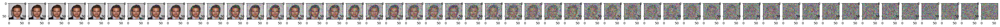

In [12]:
# Simulate forward diffusion
image = next(iter(dataloader))[0]

plt.figure(figsize=(55,55))
plt.axis('off')
num_images =50
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, int(idx/stepsize) + 1)
    img, noise = forward_diffusion_sample(image, t)
    show_tensor_image(img)

In [13]:
def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

In [ ]:
@torch.no_grad()
def sample_timestep(x, t):
    """
    Calls the model to predict the noise in the image and returns 
    the denoised image. 
    Applies noise to this image, if we are not in the last step yet.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)
    
    # Call model (current image - noise prediction)
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)
    
    if t == 0:
        # As pointed out by Luis Pereira (see YouTube comment)
        # The t's are offset from the t's in the paper
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise 

@torch.no_grad()
def sample_plot_image():
    # Sample noise
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(55,155))
    plt.axis('off')
    num_images = 50
    stepsize = int(T/num_images)

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t)
        # Edit: This is to maintain the natural range of the distribution
        img = torch.clamp(img, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i/stepsize)+1)
            show_tensor_image(img.detach().cpu())
    plt.show()            

In [15]:

def forward_diffusion_sample_batch(x_0_batch, t_batch, device="cpu"):
    """ 
    Takes a batch of images and a batch of timesteps as input and 
    returns the noisy versions of them.
    """
    # if isinstance(x_0_batch, list):
    #     x_0_batch = torch.stack(x_0_batch)
    
    noise_batch = torch.randn_like(x_0_batch)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t_batch, x_0_batch.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t_batch, x_0_batch.shape
    )
    
    return (
        sqrt_alphas_cumprod_t.to(device) * x_0_batch.to(device)
        + sqrt_one_minus_alphas_cumprod_t.to(device) * noise_batch.to(device), 
        noise_batch.to(device)
    )

In [16]:
import torch
from torch import optim
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
optimizer = optim.Adam(model.parameters(), lr=0.01)
epochs = 30 # Try more!

In [17]:
import torch

# ----- Saving the checkpoint -----
def save_checkpoint(model, optimizer, epoch, loss, filename="checkpoint.pth"):
    checkpoint = {
        "epoch": epoch,
        "model_state_dict": model.state_dict(),
        "optimizer_state_dict": optimizer.state_dict(),
        "loss": loss,
    }
    torch.save(checkpoint, filename)
    print(f"Checkpoint saved to {filename}")

# Example usage:
# Assuming `model` and `optimizer` are defined and you have the current epoch and loss
epoch = 10
loss = 0.1234
save_checkpoint(model, optimizer, epoch, loss, filename="checkpoint.pth")

# ----- Loading the checkpoint -----
def load_checkpoint(model, optimizer, filename="checkpoint.pth"):
    checkpoint = torch.load(filename)
    model.load_state_dict(checkpoint["model_state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer_state_dict"])
    epoch = checkpoint["epoch"]
    loss = checkpoint["loss"]
    
    print(f"Checkpoint loaded from {filename} (epoch {epoch})")
    return epoch, loss

# Example usage:
# Assuming `model` and `optimizer` are already created and are of the same architecture as saved
loaded_epoch, loaded_loss = load_checkpoint(model, optimizer, filename="checkpoint.pth")

Checkpoint saved to checkpoint.pth


<ipython-input-17-53ff43f95f66>:22: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(filename)


Checkpoint loaded from checkpoint.pth (epoch 10)


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch [0/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.41]


0.0075
Epoch 0 | step 1581 Loss: 0.2064490020275116 


<ipython-input-14-7f5127376a4b>:44: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, int(i/stepsize)+1)


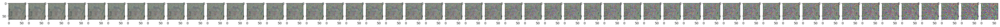

Checkpoint saved to checkpoint6.pth


Epoch [1/30]: 100%|██████████| 1582/1582 [09:50<00:00,  2.68it/s, loss=0.19]


0.005625
Epoch 1 | step 1581 Loss: 0.17113780975341797 


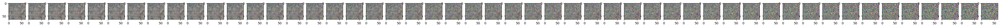

Checkpoint saved to checkpoint6.pth


Epoch [2/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.68it/s, loss=0.18]


0.00421875
Epoch 2 | step 1581 Loss: 0.1701502650976181 


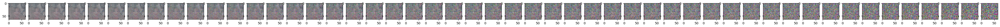

Checkpoint saved to checkpoint6.pth


Epoch [3/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.68it/s, loss=0.176]


0.0031640625
Epoch 3 | step 1581 Loss: 0.16021308302879333 


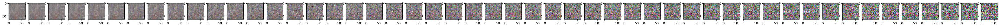

Checkpoint saved to checkpoint6.pth


Epoch [4/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.173]


0.002373046875
Epoch 4 | step 1581 Loss: 0.17646396160125732 


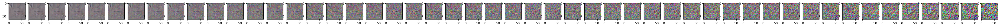

Checkpoint saved to checkpoint6.pth


Epoch [5/30]: 100%|██████████| 1582/1582 [09:53<00:00,  2.67it/s, loss=0.172]


0.0017797851562500002
Epoch 5 | step 1581 Loss: 0.16675174236297607 


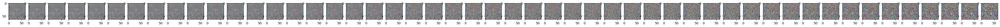

Checkpoint saved to checkpoint6.pth


Epoch [6/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.171]


0.0013348388671875003
Epoch 6 | step 1581 Loss: 0.1652635782957077 


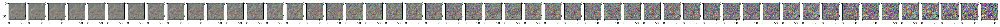

Checkpoint saved to checkpoint6.pth


Epoch [7/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.17]


0.0010011291503906252
Epoch 7 | step 1581 Loss: 0.16392746567726135 


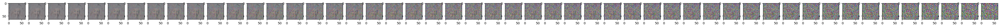

Checkpoint saved to checkpoint6.pth


Epoch [8/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.169]


0.0007508468627929689
Epoch 8 | step 1581 Loss: 0.17132894694805145 


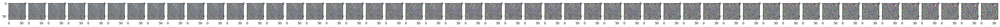

Checkpoint saved to checkpoint6.pth


Epoch [9/30]: 100%|██████████| 1582/1582 [09:56<00:00,  2.65it/s, loss=0.169]


0.0005631351470947267
Epoch 9 | step 1581 Loss: 0.16753241419792175 


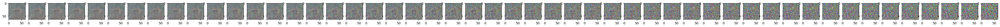

Checkpoint saved to checkpoint6.pth


Epoch [10/30]: 100%|██████████| 1582/1582 [09:53<00:00,  2.67it/s, loss=0.168]


0.000422351360321045
Epoch 10 | step 1581 Loss: 0.17893457412719727 


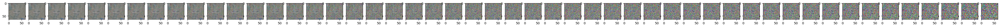

Checkpoint saved to checkpoint6.pth


Epoch [11/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.168]


0.00031676352024078374
Epoch 11 | step 1581 Loss: 0.1590789258480072 


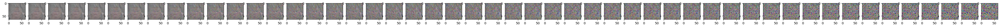

Checkpoint saved to checkpoint6.pth


Epoch [12/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.168]


0.00023757264018058782
Epoch 12 | step 1581 Loss: 0.1635448932647705 


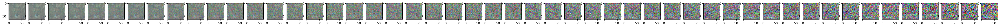

Checkpoint saved to checkpoint6.pth


Epoch [13/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.167]


0.00017817948013544086
Epoch 13 | step 1581 Loss: 0.16562871634960175 


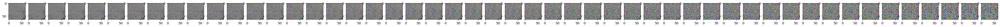

Checkpoint saved to checkpoint6.pth


Epoch [14/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.167]


0.00013363461010158065
Epoch 14 | step 1581 Loss: 0.1669776886701584 


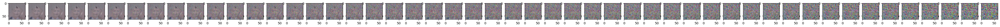

Checkpoint saved to checkpoint6.pth


Epoch [15/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.167]


0.00013229826400056486
0.00013
Epoch 15 | step 1581 Loss: 0.1715700626373291 


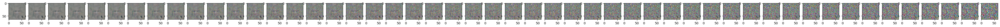

Checkpoint saved to checkpoint6.pth


Epoch [16/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.167]


0.00012869999999999998
Epoch 16 | step 1581 Loss: 0.18193423748016357 


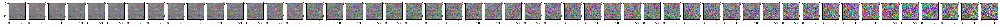

Checkpoint saved to checkpoint6.pth


Epoch [17/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.167]


0.000127413
Epoch 17 | step 1581 Loss: 0.1714116781949997 


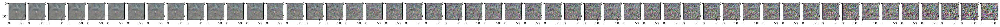

Checkpoint saved to checkpoint6.pth


Epoch [18/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.167]


0.00012613887
Epoch 18 | step 1581 Loss: 0.15671198070049286 


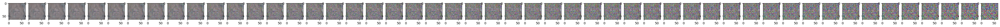

Checkpoint saved to checkpoint6.pth


Epoch [19/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.167]


0.0001248774813
Epoch 19 | step 1581 Loss: 0.16246084868907928 


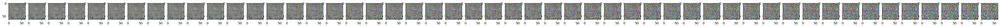

Checkpoint saved to checkpoint6.pth


Epoch [20/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.166]


0.000123628706487
Epoch 20 | step 1581 Loss: 0.1537558138370514 


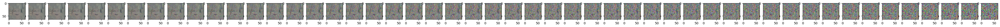

Checkpoint saved to checkpoint6.pth


Epoch [21/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.167]


0.00012239241942213
Epoch 21 | step 1581 Loss: 0.1675843894481659 


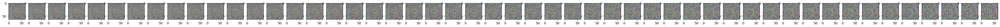

Checkpoint saved to checkpoint6.pth


Epoch [22/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.167]


0.0001211684952279087
Epoch 22 | step 1581 Loss: 0.1590448021888733 


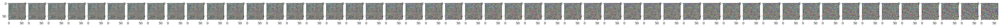

Checkpoint saved to checkpoint6.pth


Epoch [23/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.167]


0.00011995681027562962
Epoch 23 | step 1581 Loss: 0.17185787856578827 


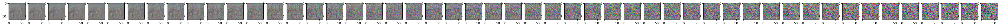

Checkpoint saved to checkpoint6.pth


Epoch [24/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.166]


0.00011875724217287332
Epoch 24 | step 1581 Loss: 0.15741491317749023 


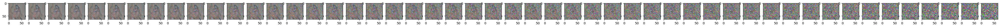

Checkpoint saved to checkpoint6.pth


Epoch [25/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.166]


0.00011756966975114458
Epoch 25 | step 1581 Loss: 0.16290119290351868 


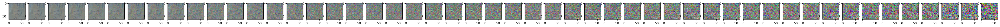

Checkpoint saved to checkpoint6.pth


Epoch [26/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.166]


0.00011639397305363313
Epoch 26 | step 1581 Loss: 0.16571669280529022 


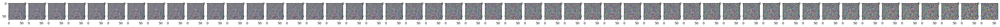

Checkpoint saved to checkpoint6.pth


Epoch [27/30]: 100%|██████████| 1582/1582 [09:51<00:00,  2.67it/s, loss=0.166]


0.0001152300333230968
Epoch 27 | step 1581 Loss: 0.15798571705818176 


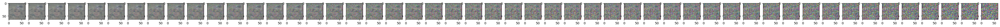

Checkpoint saved to checkpoint6.pth


Epoch [28/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.166]


0.00011407773298986582
Epoch 28 | step 1581 Loss: 0.15082955360412598 


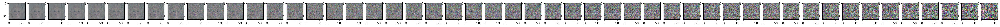

Checkpoint saved to checkpoint6.pth


Epoch [29/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.166]


0.00011293695565996717
Epoch 29 | step 1581 Loss: 0.1571764051914215 


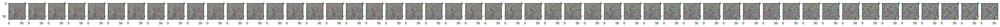

Checkpoint saved to checkpoint6.pth


Epoch [30/30]: 100%|██████████| 1582/1582 [09:52<00:00,  2.67it/s, loss=0.166]


0.0001118075861033675
Epoch 30 | step 1581 Loss: 0.15952590107917786 


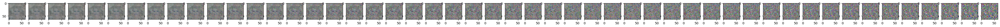

Checkpoint saved to checkpoint6.pth


In [18]:
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)

from tqdm import tqdm
for epoch in range(epochs+1):
    
    
    aloss = 0
    loop = tqdm(enumerate(dataloader), total=len(dataloader), desc=f"Epoch [{epoch}/{epochs}]")

    for step, batch in loop:
        optimizer.zero_grad()
        # print(batch[0].shape)
        t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
        
        x_noisy, noise = forward_diffusion_sample(batch[0], t, device)
        noise_pred = model(x_noisy, t)
        loss=F.l1_loss(noise, noise_pred)
        loss.backward()
        optimizer.step()
        aloss = (aloss * step + loss.item()) / (step + 1)
        loop.set_postfix(loss=aloss)
    if epoch<15:
        for param_group in optimizer.param_groups:
            param_group['lr']*= 0.75 # Reduce LR by 1%
            print(param_group['lr'])
    else:
        for param_group in optimizer.param_groups:
            param_group['lr'] *= 0.99 # Reduce LR by 1%
            print(param_group['lr'])    
    if epoch==15:
        for param_group in optimizer.param_groups:
            param_group['lr'] =1.3e-4 # Reduce LR by 1%
            print(param_group['lr'])
    print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
    scheduler.step(aloss) 
    sample_plot_image()
    save_checkpoint(model,optimizer,10,10,"checkpoint6.pth")